In [1]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 18.4 MB/s eta 0:00:00


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
from ultralytics import YOLO
import cv2
import torch;
import os
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

import warnings
warnings.filterwarnings("ignore")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [4]:
train_images_path = "/content/drive/MyDrive/YOLO/input/train/images"
train_labels_path = "/content/drive/MyDrive/YOLO/input/train/labels"
test_images_path = "/content/drive/MyDrive/YOLO/input/test/images"
test_labels_path = "/content/drive/MyDrive/YOLO/input/test/labels"
valid_images_path = "/content/drive/MyDrive/YOLO/input/valid/images"
valid_labels_path = "/content/drive/MyDrive/YOLO/input/valid/labels"

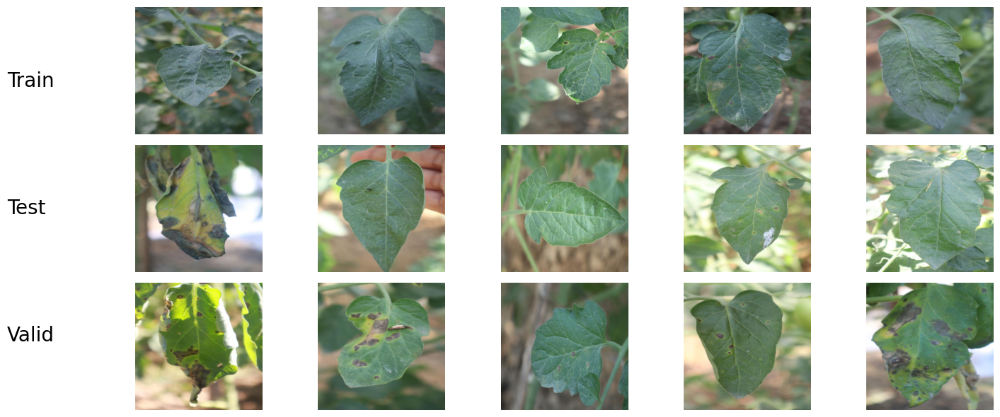

In [5]:
train_files = os.listdir(train_images_path)[:5]
test_files = os.listdir(test_images_path)[:5]
valid_files = os.listdir(valid_images_path)[:5]

num_images = 5
plt.figure(figsize=(15, 6))

for i in range(num_images):
    # ---- Train row ----
    img = cv2.imread(os.path.join(train_images_path, train_files[i]))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(3, num_images, i + 1)
    plt.imshow(img)
    plt.axis("off")

    # ---- Test row ----
    img = cv2.imread(os.path.join(test_images_path, test_files[i]))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(3, num_images, i + 1 + num_images)
    plt.imshow(img)
    plt.axis("off")

    # ---- Validation row ----
    img = cv2.imread(os.path.join(valid_images_path, valid_files[i]))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(3, num_images, i + 1 + 2*num_images)
    plt.imshow(img)
    plt.axis("off")


plt.tight_layout()
plt.subplots_adjust(left=0.1)
plt.figtext(0.02, 0.80, "Train", fontsize=20, ha="left", va="center")
plt.figtext(0.02, 0.50, "Test", fontsize=20, ha="left", va="center")
plt.figtext(0.02, 0.20, "Valid", fontsize=20, ha="left", va="center")

plt.show()

In [6]:
model = YOLO('yolo11l.pt')
model.train(
    data = '/content/drive/MyDrive/YOLO/input/data.yaml',
    epochs = 100,
    imgsz = 640,
    batch = 16,
    freeze = 10,
    device = '0',
    optimizer = 'Adam',
    amp = True,
    project = '/content/drive/MyDrive/YOLO/output/models',
    name = 'yolo11l-custom',
    augment = True,
    mosaic = True,
    mixup = True,
    close_mosaic = True
)

Ultralytics 8.3.203 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=True, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=True, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/YOLO/input/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=10, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=True, mode=train, model=yolo11l.pt, momentum=0.937, mosaic=True, multi_scale=False, name=yolo11l-custom, nbs=64, nms=False, opset=None, optimize=False, optimizer=Adam, overlap_mask=True, patience=100, perspective=

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7decbc230860>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
  

In [7]:
df = pd.read_csv('/content/drive/MyDrive/YOLO/output/models/yolo11l-custom/results.csv')


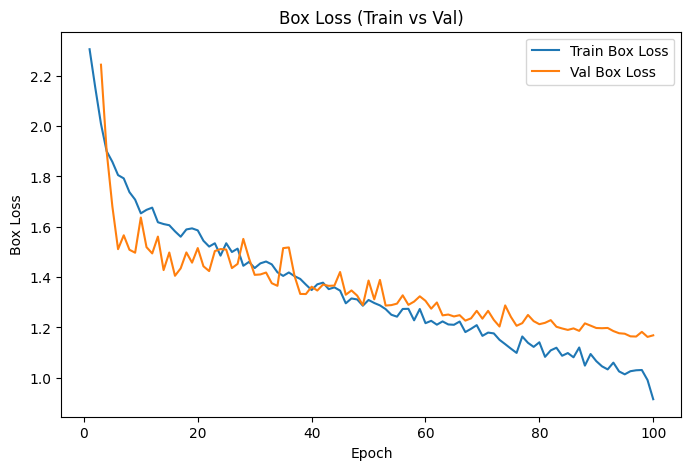

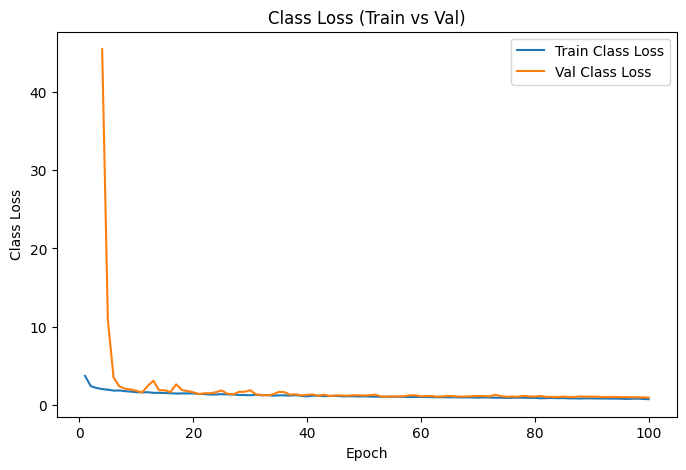

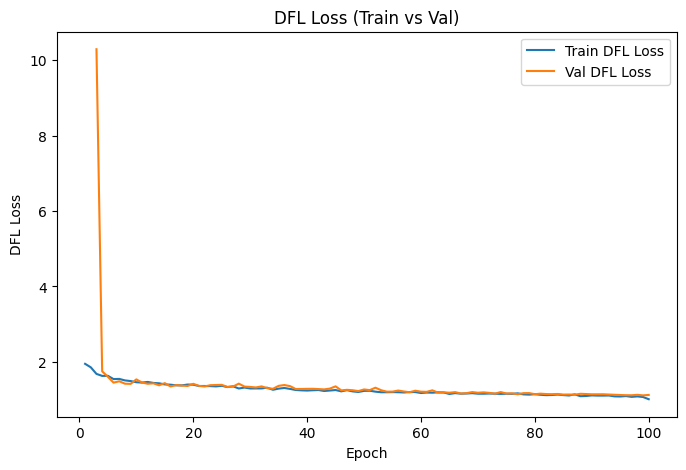

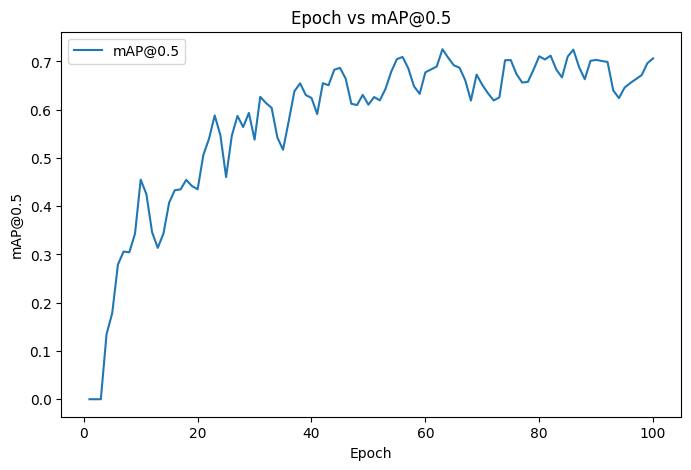

In [8]:
#--- Box Loss ---
plt.figure(figsize=(8,5))
plt.plot(df['epoch'], df['train/box_loss'], label='Train Box Loss')
plt.plot(df['epoch'], df['val/box_loss'], label='Val Box Loss')
plt.xlabel('Epoch')
plt.ylabel('Box Loss')
plt.title("Box Loss (Train vs Val)")
plt.legend()
plt.show()

# --- Class Loss ---
plt.figure(figsize=(8,5))
plt.plot(df['epoch'], df['train/cls_loss'], label='Train Class Loss')
plt.plot(df['epoch'], df['val/cls_loss'], label='Val Class Loss')
plt.xlabel('Epoch')
plt.ylabel('Class Loss')
plt.title("Class Loss (Train vs Val)")
plt.legend()
plt.show()

# --- DFL Loss ---
plt.figure(figsize=(8,5))
plt.plot(df['epoch'], df['train/dfl_loss'], label='Train DFL Loss')
plt.plot(df['epoch'], df['val/dfl_loss'], label='Val DFL Loss')
plt.xlabel('Epoch')
plt.ylabel('DFL Loss')
plt.title("DFL Loss (Train vs Val)")
plt.legend()
plt.show()

# --- mAP ---
plt.figure(figsize=(8,5))
plt.plot(df['epoch'], df['metrics/mAP50(B)'], label="mAP@0.5")
plt.xlabel('Epoch')
plt.ylabel('mAP@0.5')
plt.title("Epoch vs mAP@0.5")
plt.legend()
plt.show()

In [9]:
files = ["BoxF1_curve.png","BoxPR_curve.png","BoxP_curve.png","BoxR_curve.png","confusion_matrix.png","confusion_matrix_normalized.png"]
val_res_dir = "/content/drive/MyDrive/YOLO/output/models/yolo11l-custom/"
for file in files:
    img = cv2.imread(os.path.join(val_res_dir,file))
    cv2_imshow(img)




Output hidden; open in https://colab.research.google.com to view.

## Test Evaluation

In [10]:
model = YOLO('/content/drive/MyDrive/YOLO/output/models/yolo11l-custom/weights/best.pt')

In [11]:
results_test = model.val(
    data = '/content/drive/MyDrive/YOLO/input/data.yaml',
    split = "test",
    project = '/content/drive/MyDrive/YOLO/runs',
    name = 'model_vals'
)

Ultralytics 8.3.203 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLO11l summary (fused): 190 layers, 25,284,709 parameters, 0 gradients, 86.6 GFLOPs
val: Fast image access ✅ (ping: 0.6±0.2 ms, read: 0.1±0.0 MB/s, size: 28.5 KB)
val: Scanning /content/drive/MyDrive/YOLO/input/test/labels.cache... 31 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 31/31 42.4Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 0.3it/s 7.0s
                   all         31        119      0.672      0.779      0.754      0.469
        Bacterial Spot          2          2       0.88        0.5      0.499       0.15
          Early_Blight         15         66      0.684      0.879      0.816      0.414
               Healthy          7          7      0.717          1      0.995      0.885
           Late_blight          9         20      0.836      0.763      0.828      0.559
             Leaf Mold          4     

## Inferencia del modelo

In [12]:
results = model.predict(source = '/content/drive/MyDrive/YOLO/input/test/images', save = True, show = False, project = '/content/drive/MyDrive/YOLO/runs', name = "model_runs")


image 1/31 /content/drive/MyDrive/YOLO/input/test/images/IMG_0219_JPG.rf.c8d288f364390a28656a50ed7415713a.jpg: 640x640 1 Healthy, 47.5ms
image 2/31 /content/drive/MyDrive/YOLO/input/test/images/IMG_0233_JPG.rf.b27c3e2dd843cab5e0f652fd1ce5659a.jpg: 640x640 4 Early_Blights, 8 Leaf Molds, 2 black spots, 40.7ms
image 3/31 /content/drive/MyDrive/YOLO/input/test/images/IMG_0249_JPG.rf.412df0b52b549fc121a346eb8a957ab0.jpg: 640x640 1 Early_Blight, 1 Healthy, 40.6ms
image 4/31 /content/drive/MyDrive/YOLO/input/test/images/IMG_0277_JPG.rf.84073f240decbc79e30716373f3dd507.jpg: 640x640 3 Early_Blights, 2 Leaf Molds, 2 black spots, 37.8ms
image 5/31 /content/drive/MyDrive/YOLO/input/test/images/IMG_0281_JPG.rf.a29c913abceeed1ea6092ab0f2c92b0d.jpg: 640x640 4 Early_Blights, 1 Leaf Mold, 2 black spots, 36.8ms
image 6/31 /content/drive/MyDrive/YOLO/input/test/images/IMG_0288_JPG.rf.ca824ec09b29571c39dc6b6ee6b0f6a7.jpg: 640x640 3 Early_Blights, 1 Healthy, 1 black spot, 36.8ms
image 7/31 /content/drive/

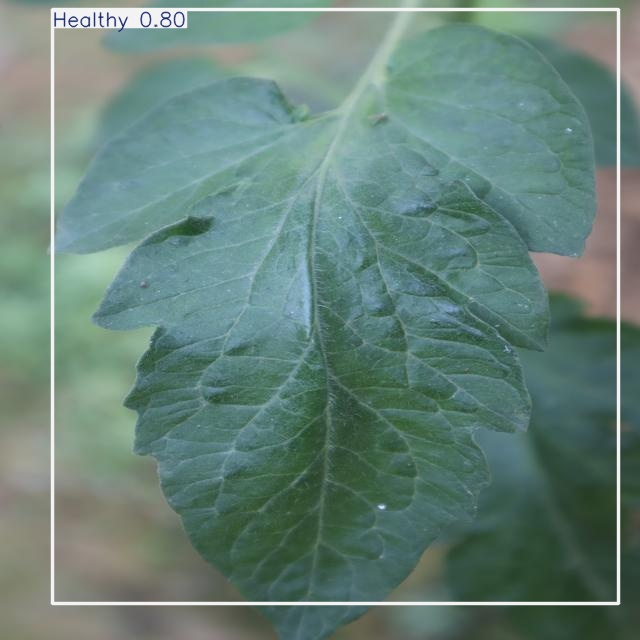

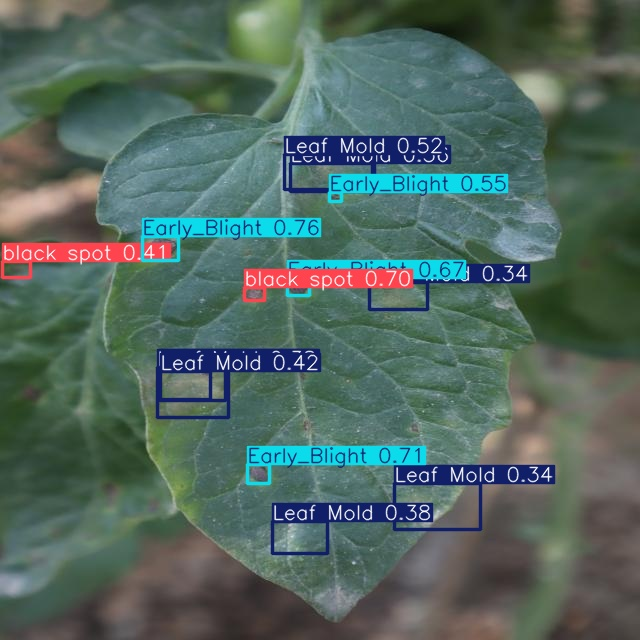

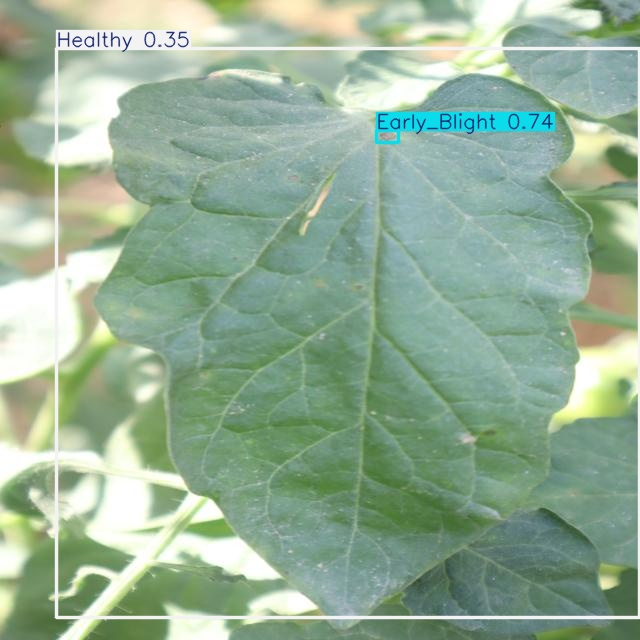

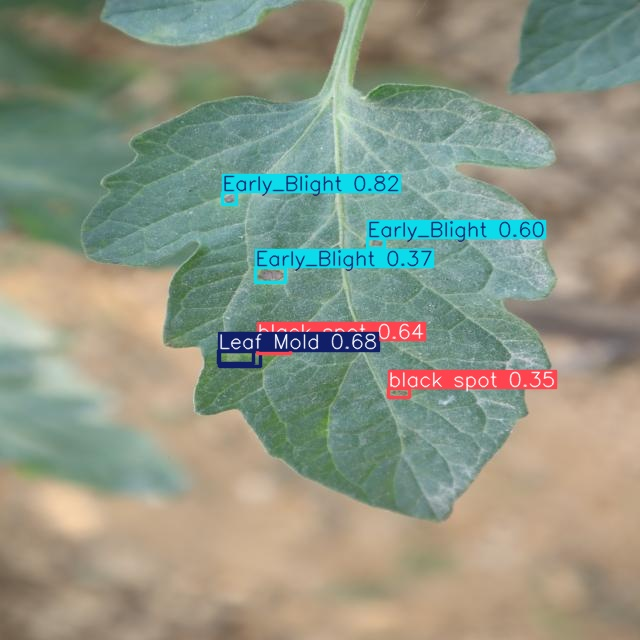

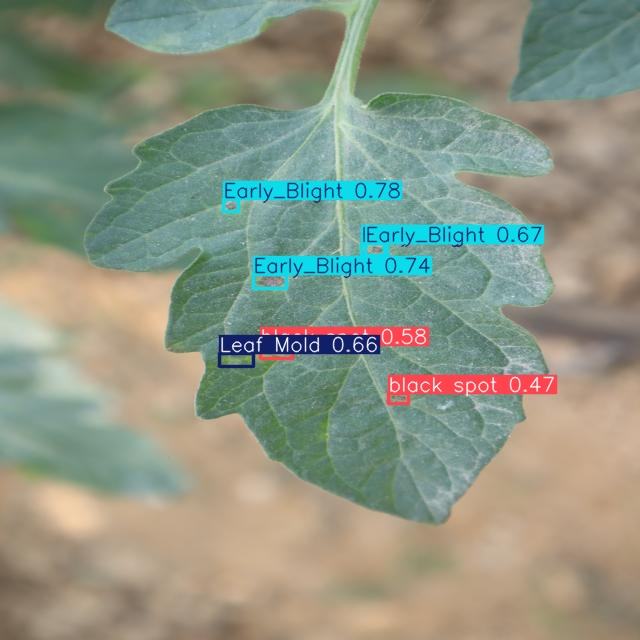

...

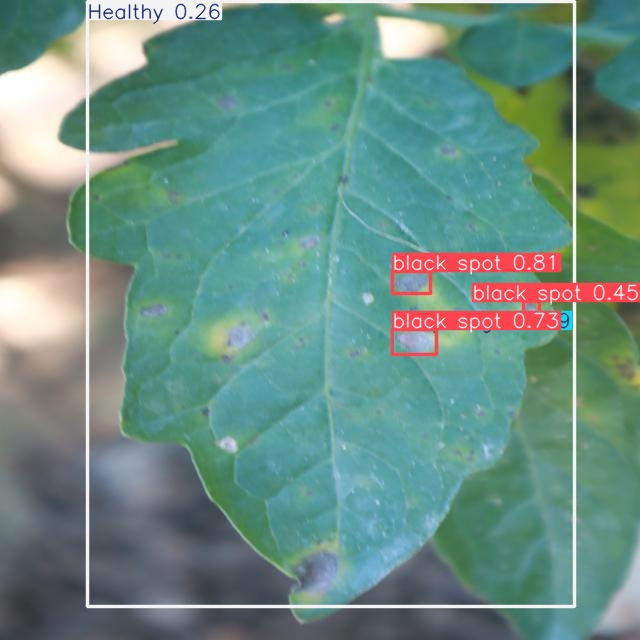

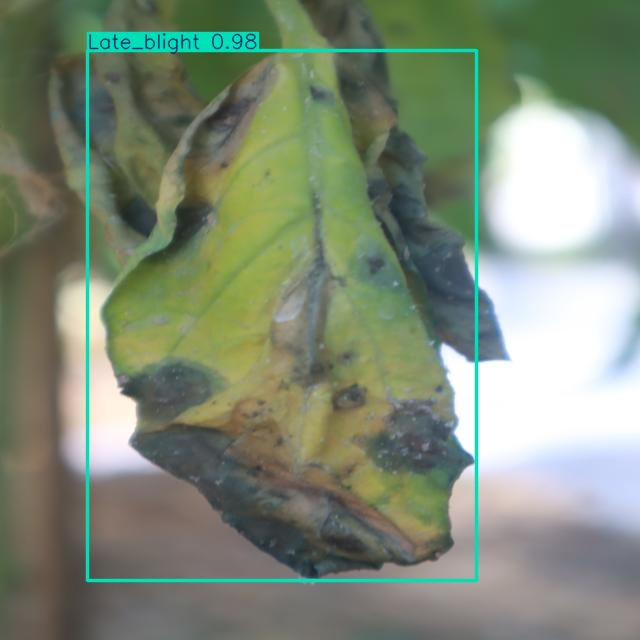

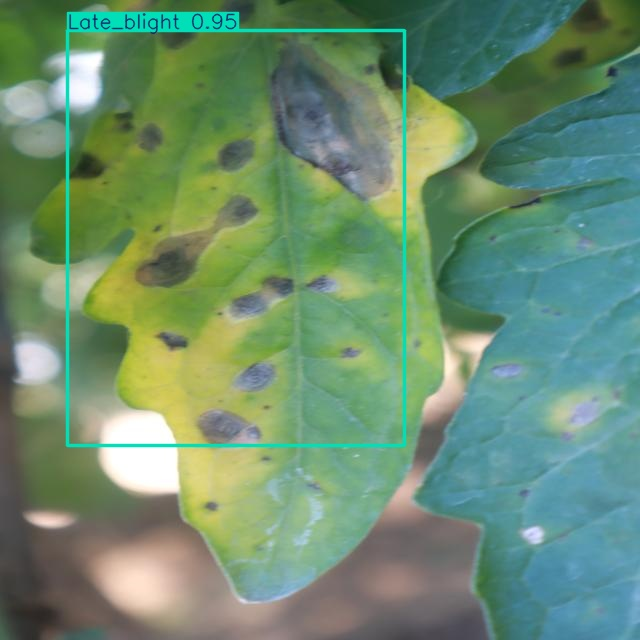

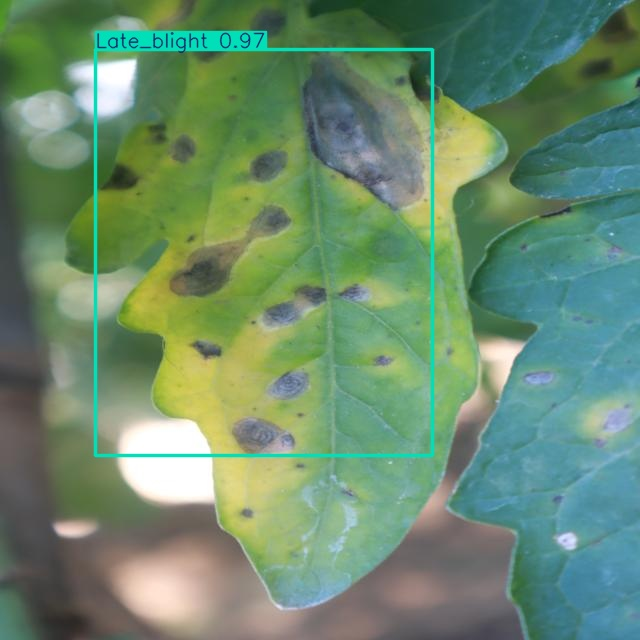

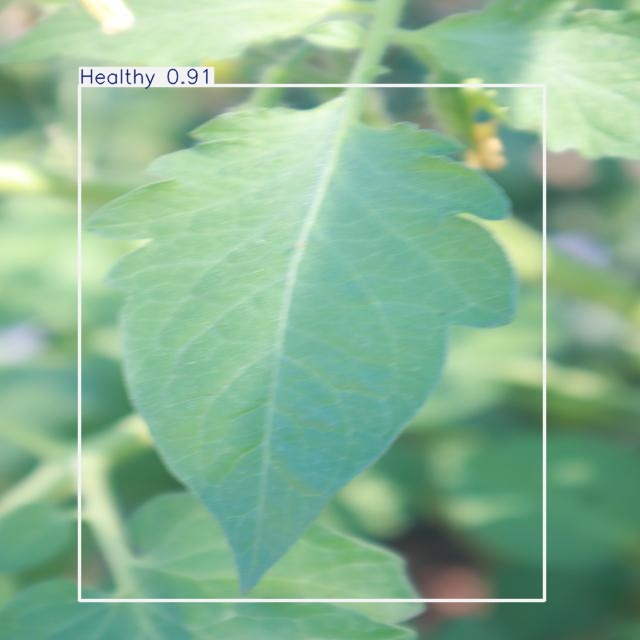

In [13]:
test_pred_path = '/content/drive/MyDrive/YOLO/runs/model_runs'

for file in os.listdir(test_pred_path):
    img = cv2.imread(os.path.join(test_pred_path,file))
    cv2_imshow(img)


image 1/1 /content/drive/MyDrive/YOLO/Image_test/modl3.jpeg: 480x640 1 Healthy, 2 Late_blights, 94.2ms
Speed: 4.0ms preprocess, 94.2ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


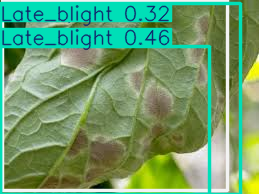

Etiqueta con mayor puntaje: Late_blight
Puntaje de confianza: 0.4605785310268402


In [14]:
model = YOLO('/content/drive/MyDrive/YOLO/output/models/yolo11l-custom/weights/best.pt')

results = model('/content/drive/MyDrive/YOLO/Image_test/modl3.jpeg')

result = results[0]

if len(result.boxes) > 0:
    best_box =  max(result.boxes, key = lambda b:b.conf)
    best_class_id = int(best_box.cls)

    highest_score_label = model.names[best_class_id]
    confidence_score = float(best_box.conf)

    cv2_imshow(result.plot())

    print(f'Etiqueta con mayor puntaje: {highest_score_label}')
    print(f'Puntaje de confianza: {confidence_score}')
else:
    print("No se encontraron objetos detectados.")